# <u>Image Analysis And Computer Vision Project<u>

## Mathieu Jacquemet
## Ribal Teeny

## Import Libraries

In [1]:
import numpy as np # grey images are stored in memory as 2D arrays, color images as 3D arrays
import cv2 as cv2 # opencv computer vision library
from skimage import io # for io.imread
from matplotlib import pyplot as plt # ploting

## Visualization Function

In [21]:
def imshow(images, titles, nrows = 0, ncols=0, figsize = (15,20)):
    if ncols == 0 and nrows == 0:
        ncols = len(images)
        nrows = 1
    if ncols == 0:
        ncols = len(images) // nrows
    if nrows == 0:
        nrows = len(images) // ncols
      
    fig, axeslist = plt.subplots(ncols=ncols, nrows=nrows, squeeze=False, figsize = figsize)
    for i, image in enumerate(images):
        axeslist.ravel()[i].imshow(image, cmap=plt.gray(), vmin=0, vmax=255)
        axeslist.ravel()[i].set_title(titles[i])
        axeslist.ravel()[i].set_axis_off()
    plt.tight_layout() # padding between figures
    
def show_contours(image):
    copy = image.copy()
    # Iterate over the contours and draw them on the original image
    contours = get_contours(image)
    for contour in contours:
        cv2.drawContours(copy, contour, -1, (0,255,0), 3)

    # Show the original image with the contours overlaid
    return copy

def showMatches(img1, kp1, img2, kp2, matches, name):
    img = cv2.drawMatches(img1,kp1,img2,kp2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    imshow([img],[name])
    
def showKps(img, kp, name, start=None, end=None):
    if start and end:
        img = cv2.rectangle(img, start, end, (0,0,255), 2)
    img1 = cv2.drawKeypoints(img,kp,img.copy())
    imshow([img1],[name])

## Processing image

In [22]:
def load(file):
    image = cv2.imread(file)
    return image

# Convert the image to grayscale
def gray_image(image):
    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    return gray_image

# Blur the image to reduce noise
def blurred_image(image):
    blurred_image = cv2.GaussianBlur(gray_image(image), (5,5), 0)
    return blurred_image
    

# Perform edge detection on the blurred image
def get_edges(image):
    edge_detected_image = cv2.Canny(blurred_image(image), 50, 150)
    return edge_detected_image

# Find contours in the edge detected image
def get_contours(image):
    contours, hierarchy = cv2.findContours(get_edges(image), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    return contours

## Recadrage

In [23]:
def get_cadre(image):
    contours = get_contours(image)
    xmin = contours[0][0][0][0]
    ymin = contours[0][0][0][1]
    xmax=contours[0][0][0][0]
    ymax =contours[0][0][0][1]
    for contour in contours:
        for coord in contour :
            if coord[0][0]<xmin:
                xmin = coord[0][0]
            if coord[0][1]<ymin:
                ymin = coord[0][1]
            if coord[0][0]>xmax:
                xmax = coord[0][0]
            if coord[0][1]>ymax:
                ymax = coord[0][1]
    return xmin,xmax,ymin,ymax

In [24]:
def process(image, kps, des):
    xmin,xmax,ymin,ymax = get_cadre(image)
    h, w  = ymax-ymin , xmax-xmin
    start = abs(h - w) // 2
    new_kps = []
    new_des = []
    processed_coordinates = []
    for idx, kp in enumerate(kps):
        point = kp.pt
        x = point[0]
        y = point[1]
        if x>=xmin and x<=xmax and y >ymin and y<ymax :
            if h>w:
                x = x+start
                processed_coordinates.append([(x-xmin)/h,(y-ymin)/h])
                new_kps.append(kp)
                new_des.append(des[idx])
            elif h<w: 
                y = y+start
                processed_coordinates.append([(x-xmin)/w,(y-ymin)/w])
                new_kps.append(kp)
                new_des.append(des[idx])
            elif h==w :
                processed_coordinates.append([(x-xmin)/w,(y-ymin)/h])
                new_kps.append(kp)
                new_des.append(des[idx])

    return processed_coordinates, np.array(new_kps), np.array(new_des), (xmin, ymin), (xmax, ymax)

## Feature Detection and Matching

In [25]:
def extract_key_points(img1, img2): #using AKAZE opencv feature extractor and descriptor to detect and compute features on 2 images
    sift = cv2.SIFT_create()
    gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
    gray2= cv2.cvtColor(img2,cv2.COLOR_BGR2GRAY)
    kp1, des1 = sift.detectAndCompute(gray1,None)
    kp2, des2 = sift.detectAndCompute(gray2,None)
    
    return kp1, des1, kp2, des2

def extract_key_points(img1): #using SIFT opencv feature extractor and descriptor to detect and compute features on 2 images
    orb = cv2.ORB_create(nfeatures=2000)
    gray_img = cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
    kp, des = orb.detectAndCompute(gray_img, None)
    return kp, des
    
    """sift = cv2.SIFT_create()
    gray1= cv2.cvtColor(img1,cv2.COLOR_BGR2GRAY)
    kp1, des1 = sift.detectAndCompute(gray1,None)    
    return kp1, des1"""

def match_key_points(kp1, des1, kp2, des2):  # match the features between images. The quality of each match is measured in the distance property of the match
    bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)
    matches = bf.match(des1,des2)
    return sorted(matches, key = lambda x:x.distance) # sort the matches by increasing distance so that the first matches of the list are the more relevant.
    

In [26]:
def cut_matches_by_treshold(matches, threshold):
    for i, m in enumerate(matches):
        if m.distance > threshold:
            return matches[:i]
    return matches

## Evaluating feature match

In [27]:
def diff(matches, points, points_test, min_match):
    diff = 0
    for i in range(min_match):
        idx = matches[i].queryIdx
        idtest = matches[i].trainIdx
        ytest = points_test[idtest][1]
        y=points[idx][1]
        xtest=points_test[idtest][0]
        x=points[idx][0]
        d = (y-ytest)*(y-ytest) + (x-xtest)*(x-xtest)
        diff+= np.sqrt(d)
    return diff/10

def diffDistance(matches):
    diff = 0
    for m in matches:
        diff += m.distance
    return diff

def diff2(matches, points, points_test, min_match):
    diff = 0
    for i in range(min_match):
        idx = matches[i].queryIdx
        idtest = matches[i].trainIdx
        ytest = points_test[idtest][1]
        y=points[idx][1]
        xtest=points_test[idtest][0]
        x=points[idx][0]
        d = matches[i].distance * ((y-ytest)*(y-ytest) + (x-xtest)*(x-xtest))
        diff+= np.sqrt(d)
    return diff/10

## Testing

In [28]:
def run(testFile, filenames, threshold, min_match, visualize=True):
    # get testing image features
    imTest = load(testFile)
    kpT0, desT0 = extract_key_points(imTest)  
    coordTest, kpT, desT, _, _ = process(imTest, kpT0, desT0)
    
    # loop over all letter images
    result = {}
    for f in filenames:
        im = load(f)
        if visualize:
            show_contours(im)
        # extract kps and ds for im
        kp0, des0 = extract_key_points(im)
        if visualize:
            # show key points
            showKps(im, kp0, f[-5])
        # recadrer et redimensionner
        coord, kp, des, start, end = process(im, kp0, des0)
        if visualize:
            showKps(im, kp, f[-5]+"_recadrer", start, end)
        # match key points (newkpTest, newdesTest, newkp, newdes)
        matches = match_key_points(kp, des, kpT, desT)
        # select best matches (if more than 10)
        matches = cut_matches_by_treshold(matches, threshold)
        if len(matches) < min_match:
            continue # not enough matches skip letter
        # evaluate best features against test image features
        result[f[-5]] = diff(matches, coord, coordTest, min_match)
        #result[f[-5]] = diffDistance(matches)
    return result

C:\Users\ribal\AppData\Local\Temp\ipykernel_30556\1352269293.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axeslist = plt.subplots(ncols=ncols, nrows=nrows, squeeze=False, figsize = figsize)


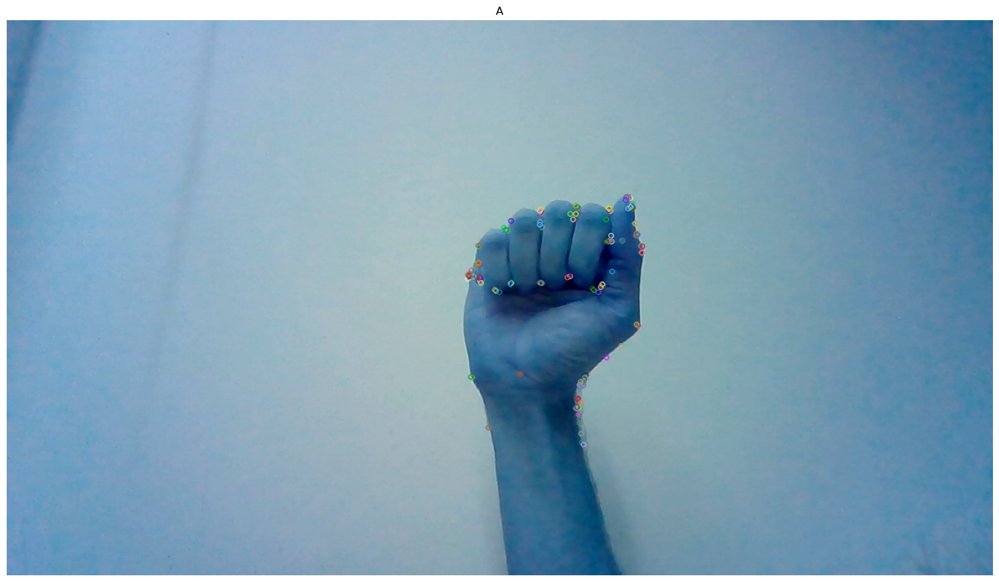

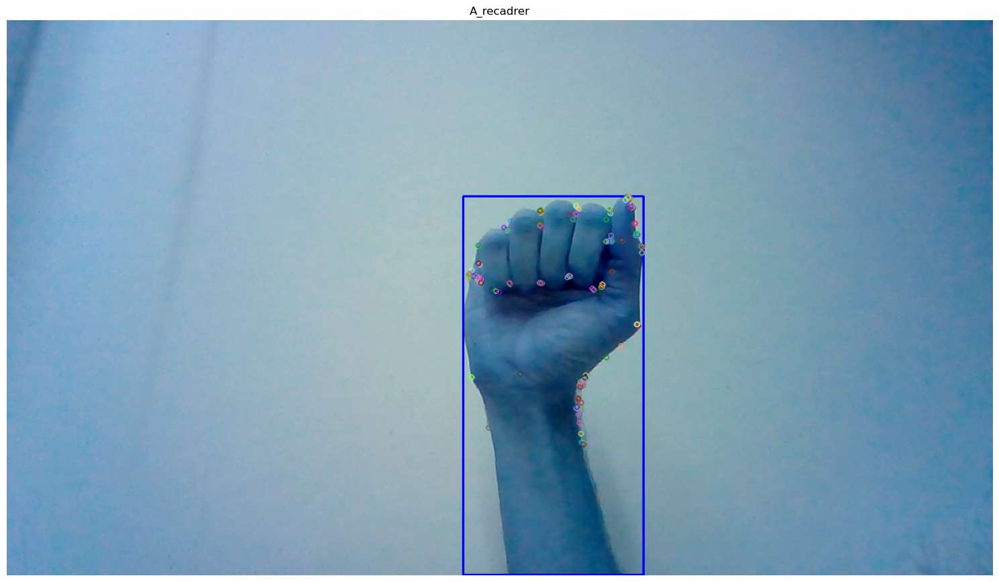

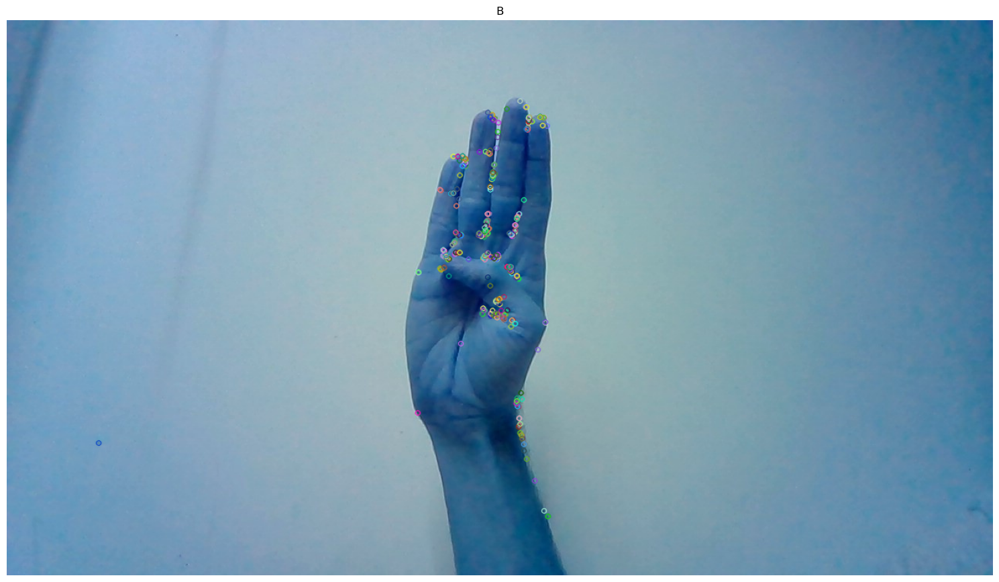

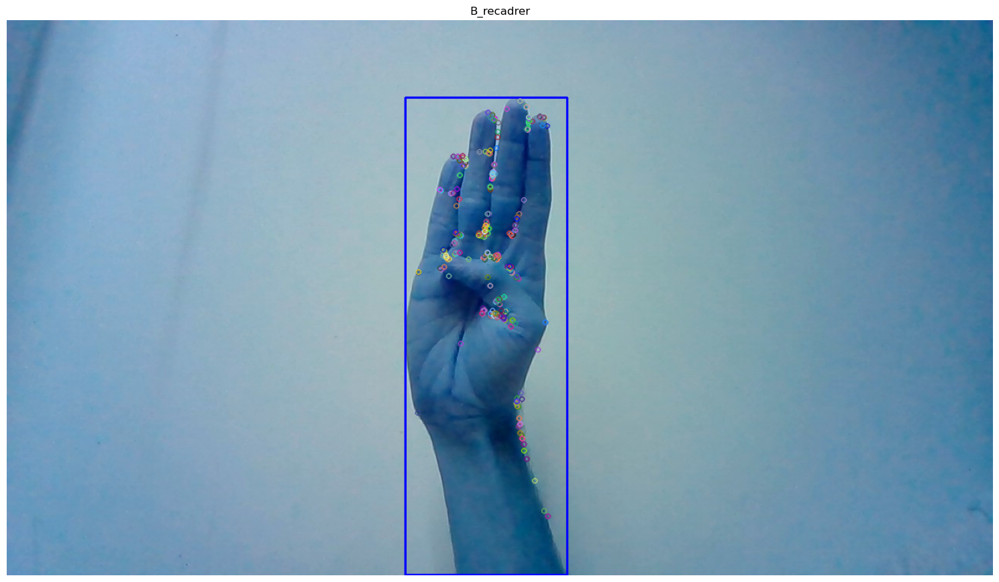

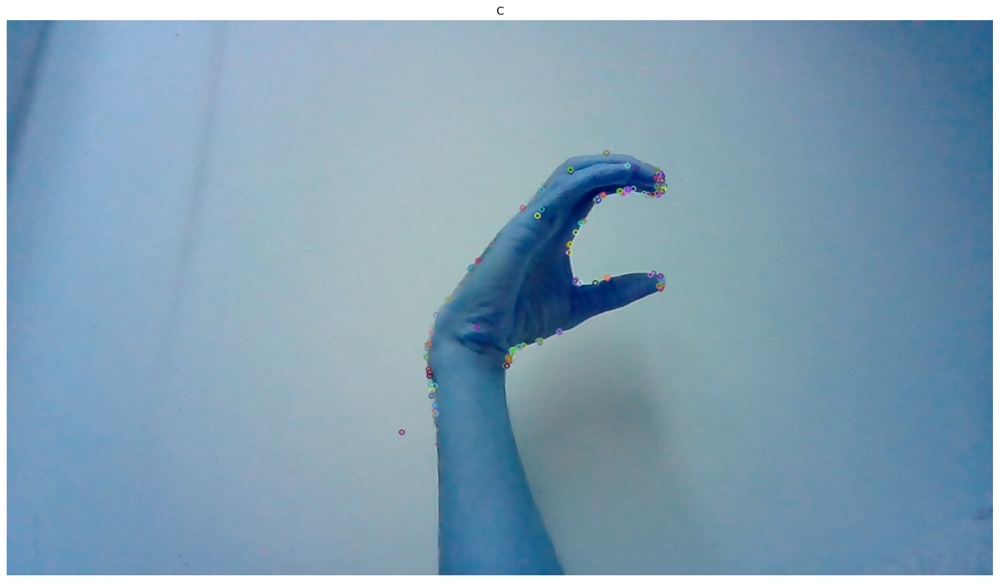

...

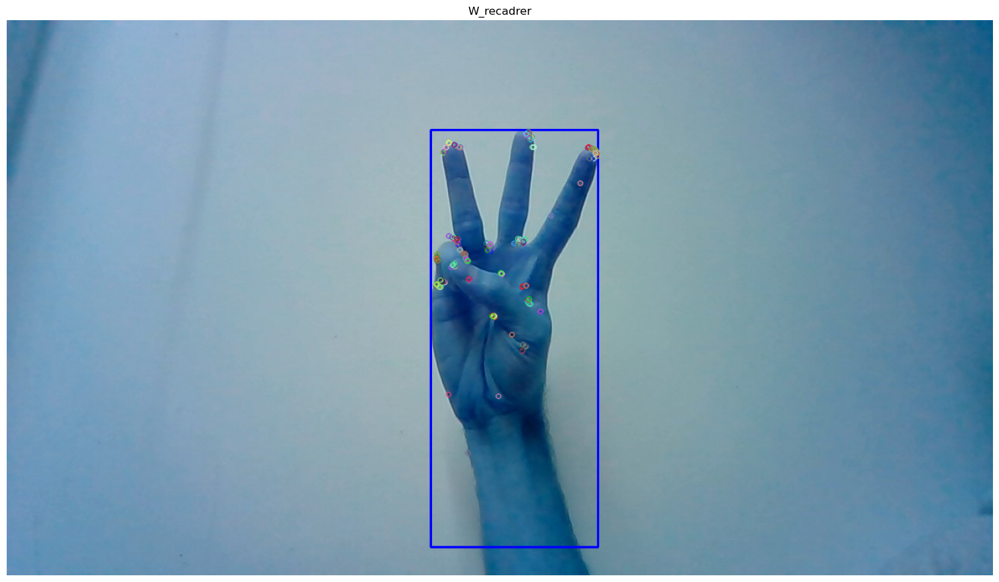

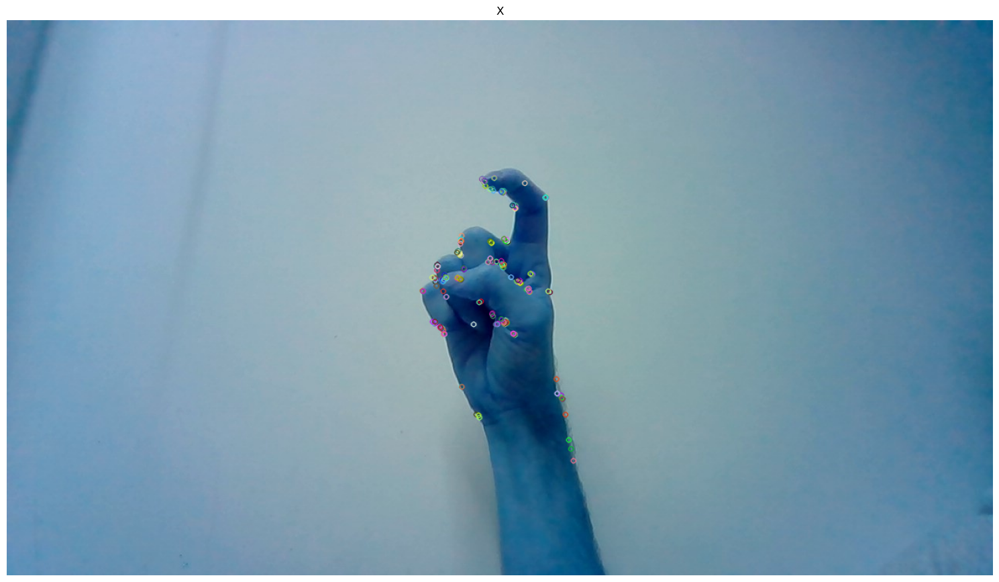

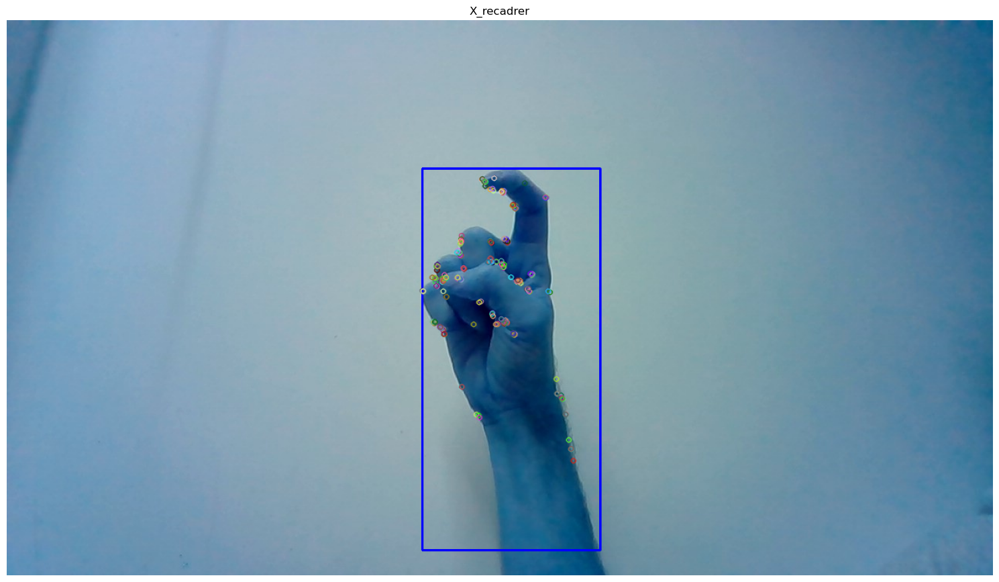

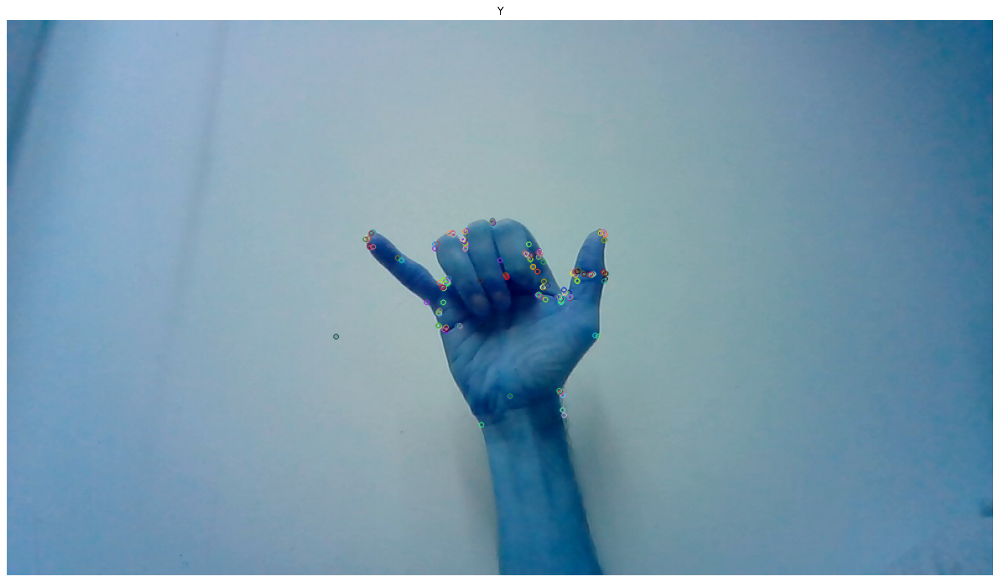

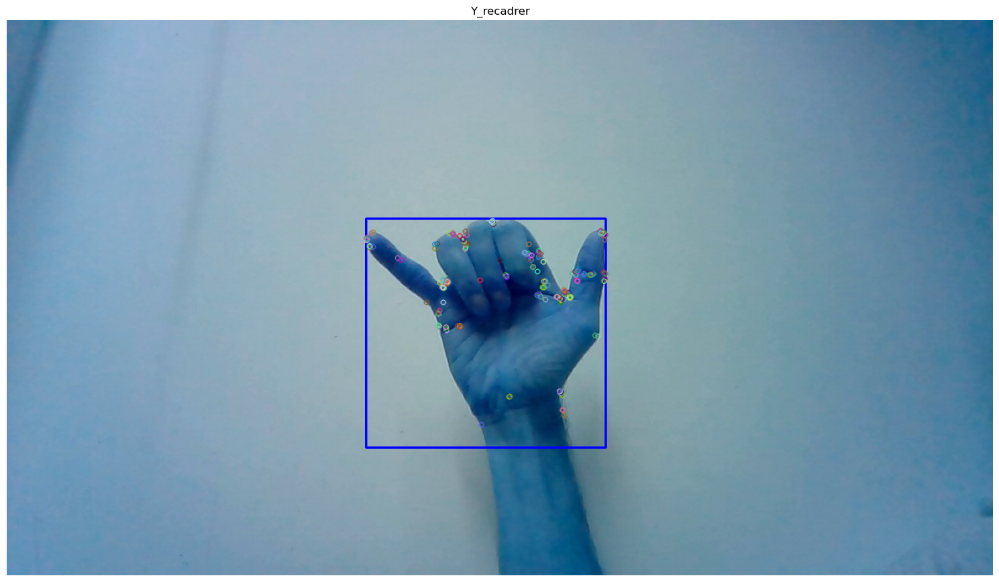

In [29]:
testFile = "./data/L.jpg"
letters = "ABCDEFGHKLMNOPQRSTUVWXY" # note J and Z missing
filenames = ["./data/%s.jpg" %letter for letter in letters]
threshold = 1200
min_match = 10

result = run(testFile, filenames, threshold, min_match)

In [30]:
result

{'A': 0.23195742200277833,
 'B': 0.22214272141570643,
 'C': 0.29932614586091055,
 'D': 0.1610072550580774,
 'E': 0.22859942339403871,
 'F': 0.2743654083687187,
 'G': 0.23836202077177399,
 'H': 0.26508328064222575,
 'K': 0.24179097166077584,
 'L': 0.0,
 'M': 0.2503556982229703,
 'N': 0.37315377131244115,
 'O': 0.3209370063459338,
 'P': 0.25912391821583614,
 'Q': 0.2369640401593604,
 'R': 0.24117403065460064,
 'S': 0.1963068262489936,
 'T': 0.3188015792984855,
 'U': 0.3082577450109074,
 'V': 0.23608205923558953,
 'W': 0.2986605183869585,
 'X': 0.29466127349921184,
 'Y': 0.35909159166619115}